# **NOAA Dataset Analysis**

### **Import Libraries**

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import folium


### **Temperature Dataset**

In [2]:
# Load the dataset
tmp_data = pd.read_csv('/content/temperature.csv')
tmp_data


,ID,Date,Element,Data_Value
0,USW00094889,2014-11-12,TMAX,22
1,USC00208972,2009-04-29,TMIN,56
2,USC00200032,2008-05-26,TMAX,278
3,USC00205563,2005-11-11,TMAX,139
4,USC00200230,2014-02-27,TMAX,-106
...,...,...,...,...
165080,USC00205822,2015-06-09,TMAX,256
165081,USC00205822,2009-10-06,TMAX,167
165082,USC00205050,2014-07-14,TMAX,283
165083,USC00200230,2006-11-29,TMIN,117


In [3]:
tmp_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 165085 entries, 0 to 165084
Data columns (total 4 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   ID          165085 non-null  object
 1   Date        165085 non-null  object
 2   Element     165085 non-null  object
 3   Data_Value  165085 non-null  int64 
dtypes: int64(1), object(3)
memory usage: 5.0+ MB



 **Familiarize yourself with the dataset, then write some python code which returns a line graph of the record high and record low temperatures by day of the year over the period 2005-2014. The area between the record high and record low temperatures for each day should be shaded.**

In [4]:
 #Convert 'date' column to datetime format
tmp_data['Date'] = pd.to_datetime(tmp_data['Date'])


In [5]:
tmp_data.dtypes

,0
ID,object
Date,datetime64[ns]
Element,object
Data_Value,int64


In [6]:
# Filter data for the years 2005-2014
data_2005_2014 = tmp_data[(tmp_data['Date'].dt.year >= 2005) & (tmp_data['Date'].dt.year <= 2014)]

In [7]:
#Create a new column for 'day_of_year' without considering the year
data_2005_2014['day_of_year1'] = data_2005_2014['Date'].dt.strftime('%m-%d')

<ipython-input-7-148143fc7738>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_2005_2014['day_of_year1'] = data_2005_2014['Date'].dt.strftime('%m-%d')


In [8]:
# Separate TMAX and TMIN records
tmax_data = data_2005_2014[tmp_data['Element'] == 'TMAX']
tmin_data = data_2005_2014[tmp_data['Element'] == 'TMIN']

<ipython-input-8-4970ef2834f5>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  tmax_data = data_2005_2014[tmp_data['Element'] == 'TMAX']
<ipython-input-8-4970ef2834f5>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  tmin_data = data_2005_2014[tmp_data['Element'] == 'TMIN']


In [9]:
# Group by day of year and find the record high (max TMAX) and record low (min TMIN)
record_highs = tmax_data.groupby('day_of_year1')['Data_Value'].max() / 10  # Convert to degrees Celsius
record_lows = tmin_data.groupby('day_of_year1')['Data_Value'].min() / 10   # Convert to degrees Celsius


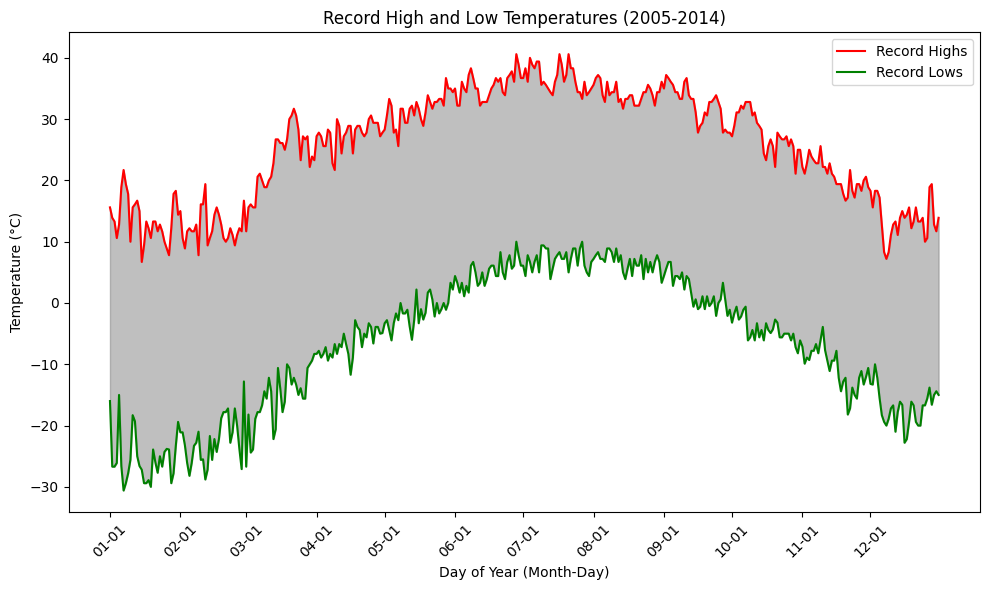

In [10]:
#Plot the record high and record low temperatures
plt.figure(figsize=(10,6))
plt.plot(record_highs.index, record_highs, color='red', label='Record Highs')
plt.plot(record_lows.index, record_lows, color='green', label='Record Lows')
# Fill the area between the highs and lows
plt.fill_between(record_highs.index, record_highs, record_lows, color='grey', alpha=0.5)
# Rotate x-axis labels for better readability
plt.xticks(rotation=45, fontsize=8)
plt.xlabel('Day of Year (Month-Day)')
plt.ylabel('Temperature (°C)')
plt.title('Record High and Low Temperatures (2005-2014)')
plt.legend()
#reduce the number of x-ticks: show only the first day of each month
# Create a list of major ticks (e.g., '01-01', '02-01', ..., '12-01')
major_ticks = ['01-01', '02-01', '03-01', '04-01', '05-01', '06-01', '07-01', '08-01', '09-01', '10-01', '11-01', '12-01']
plt.xticks(major_ticks, rotation=45, fontsize=10)  # Rotate for readability
plt.tight_layout()
plt.show()

From the above graph we can see that:
* The summer months (June, July, and August) have the highest peaks, reaching record high temperatures, while the winter months (December, January, and February) show the lowest peaks.

* In winter months, the record lows drop significantly, particularly in January and February.
* Overall we can say that the winter months show more drastic temperature swings, while the summer has more stable high and low temperatures.

The area between the record high and record low temperatures is shaded to highlight the daily temperature range over this 10-year period(2004-2015).

**Overlay a scatter of the 2015 data for any points (highs and lows) for which the ten year record (2005-2014) record high or record low was broken in 2015.**


In [11]:
# Filter data for the years 2005-2014 and 2015 separately
#data_2005_2014 = tmp_data[(tmp_data['Date'].dt.year >= 2005) & (tmp_data['Date'].dt.year <= 2014)]
data_2015 = tmp_data[tmp_data['Date'].dt.year == 2015]

In [12]:
# Create a new column for 'day_of_year' without considering the year
#data_2005_2014['day_of_year'] = data_2005_2014['Date'].dt.strftime('%m-%d')
data_2015['day_of_year'] = data_2015['Date'].dt.strftime('%m-%d')

<ipython-input-12-3248106041e2>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_2015['day_of_year'] = data_2015['Date'].dt.strftime('%m-%d')


In [13]:
# Separate TMAX and TMIN records
tmax_data_2005_2014 = data_2005_2014[data_2005_2014['Element'] == 'TMAX']
tmin_data_2005_2014 = data_2005_2014[data_2005_2014['Element'] == 'TMIN']
tmax_data_2015 = data_2015[data_2015['Element'] == 'TMAX']
tmin_data_2015 = data_2015[data_2015['Element'] == 'TMIN']

In [14]:
# Group by day of year and find the record high (max TMAX) and record low (min TMIN)
record_highs1 = tmax_data_2005_2014.groupby('day_of_year1')['Data_Value'].max() / 10  # Convert to degrees Celsius
record_lows1= tmin_data_2005_2014.groupby('day_of_year1')['Data_Value'].min() / 10   # Convert to degrees Celsius

In [15]:
# Find 2015 highs and lows
tmax_2015 = tmax_data_2015.groupby('day_of_year')['Data_Value'].max() / 10  # Convert to degrees Celsius
tmin_2015 = tmin_data_2015.groupby('day_of_year')['Data_Value'].min() / 10  # Convert to degrees Celsius

In [16]:
# Align the indices of 2015 data with the 2005-2014 records by reindexing
tmax_2015 = tmax_2015.reindex(record_highs1.index)
tmin_2015 = tmin_2015.reindex(record_lows1.index)

In [17]:
# Identify where the 2015 data breaks the 2005-2014 record
broken_highs = tmax_2015[tmax_2015 > record_highs1]
broken_lows = tmin_2015[tmin_2015 < record_lows1]

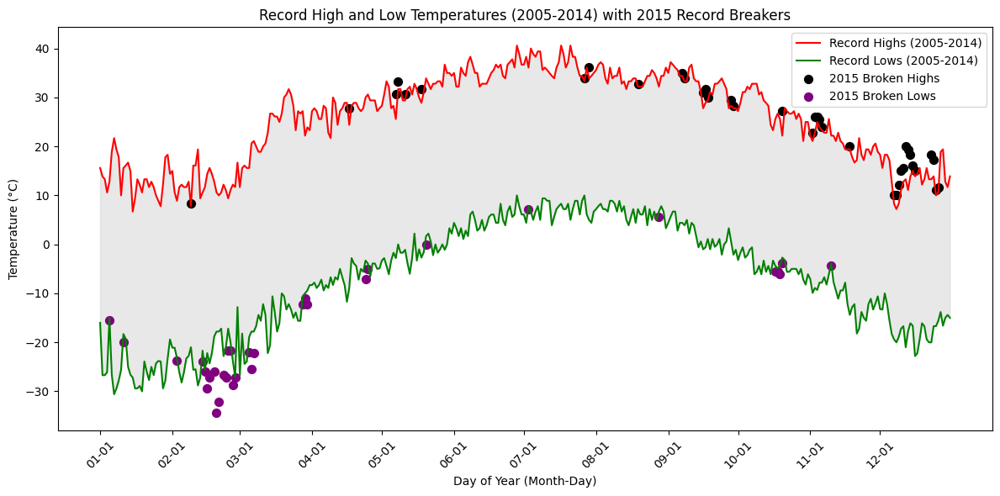

In [18]:
# Plot the record high and record low temperatures from 2005-2014
plt.figure(figsize=(12,6))

# Plotting record highs and lows
plt.plot(record_highs1.index, record_highs1, color='red', label='Record Highs (2005-2014)')
plt.plot(record_lows1.index, record_lows1, color='green', label='Record Lows (2005-2014)')

# Fill the area between the highs and lows
plt.fill_between(record_highs1.index, record_highs1, record_lows1, color='lightgrey', alpha=0.5)

# Overlay the broken 2015 records with scatter points
plt.scatter(broken_highs.index, broken_highs, color='black', label='2015 Broken Highs', marker='o', s=50)
plt.scatter(broken_lows.index, broken_lows, color='purple', label='2015 Broken Lows', marker='o', s=50)

# Add labels and title
plt.xlabel('Day of Year (Month-Day)')
plt.ylabel('Temperature (°C)')
plt.title('Record High and Low Temperatures (2005-2014) with 2015 Record Breakers')
plt.legend()

# Reduce the number of x-ticks: show only the first day of each month
major_ticks = ['01-01', '02-01', '03-01', '04-01', '05-01', '06-01', '07-01', '08-01', '09-01', '10-01', '11-01', '12-01']
plt.xticks(major_ticks, rotation=45, fontsize=10)
plt.tight_layout()
plt.show()

* Several scatter points above the record high line shows that 2015 experienced higher temperatures than the previous record (2005-2014) on certain days and these are in summer months (June, July, and August).

* Most of these record-breaking low points are found in winter months (January, February, and December).

In [19]:
# check records are broken
print("\nBroken Highs in 2015:")
print(broken_highs)
print("\nBroken Lows in 2015:")
print(broken_lows)



Broken Highs in 2015:
day_of_year1
02-09     8.3
04-17    27.8
05-07    30.6
05-08    33.3
05-11    30.6
05-18    31.7
07-27    33.9
07-29    36.1
08-19    32.8
09-07    35.0
09-08    33.9
09-16    31.1
09-17    31.7
09-18    30.0
09-28    29.4
09-29    28.3
10-20    27.2
11-02    22.8
11-03    26.1
11-04    26.1
11-05    25.6
11-06    23.9
11-18    20.0
12-07    10.0
12-08    10.0
12-09    12.2
12-10    15.0
12-11    15.6
12-12    20.0
12-13    19.4
12-14    18.3
12-15    16.1
12-16    15.0
12-23    18.3
12-24    17.2
12-25    11.1
12-26    11.7
Name: Data_Value, dtype: float64

Broken Lows in 2015:
day_of_year1
01-05   -15.5
01-11   -20.0
02-03   -23.8
02-14   -23.9
02-15   -26.0
02-16   -29.4
02-17   -27.2
02-19   -26.0
02-20   -34.3
02-21   -32.2
02-23   -26.7
02-24   -27.2
02-25   -21.7
02-26   -21.6
02-27   -28.8
02-28   -27.2
03-05   -22.1
03-06   -25.5
03-07   -22.2
03-28   -12.2
03-29   -11.1
03-30   -12.2
04-24    -7.1
04-25    -5.0
05-20     0.0
07-03     7.2
08-28     5.6


**Watch out for leap days (i.e. February 29th), it is reasonable to remove these points from the dataset for the purpose of this visualization.**

In [20]:
#check leap days data
tmp_data[(tmp_data['Date'].dt.month == 2) & (tmp_data['Date'].dt.day == 29)]
tmp_data


,ID,Date,Element,Data_Value
0,USW00094889,2014-11-12,TMAX,22
1,USC00208972,2009-04-29,TMIN,56
2,USC00200032,2008-05-26,TMAX,278
3,USC00205563,2005-11-11,TMAX,139
4,USC00200230,2014-02-27,TMAX,-106
...,...,...,...,...
165080,USC00205822,2015-06-09,TMAX,256
165081,USC00205822,2009-10-06,TMAX,167
165082,USC00205050,2014-07-14,TMAX,283
165083,USC00200230,2006-11-29,TMIN,117


In [21]:
#remove leap days
tmp_data= tmp_data[~((tmp_data['Date'].dt.month == 2) & (tmp_data['Date'].dt.day == 29))]
tmp_data

,ID,Date,Element,Data_Value
0,USW00094889,2014-11-12,TMAX,22
1,USC00208972,2009-04-29,TMIN,56
2,USC00200032,2008-05-26,TMAX,278
3,USC00205563,2005-11-11,TMAX,139
4,USC00200230,2014-02-27,TMAX,-106
...,...,...,...,...
165080,USC00205822,2015-06-09,TMAX,256
165081,USC00205822,2009-10-06,TMAX,167
165082,USC00205050,2014-07-14,TMAX,283
165083,USC00200230,2006-11-29,TMIN,117


Leap days (February 29) can cause inconsistencies since they don't occur every year. Removing records for February 29th from the temperature dataset to ensure that year-over-year comparisons are valid.

# **Dataset**

In [24]:
stations_data = pd.read_csv('/content/BinSize.csv')
stations_data

,ID,LATITUDE,LONGITUDE,ELEVATION,STATE,NAME,GSNFLAG,HCNFLAG,WMOID,x,y,x_group,y_group,xy_group,hash
0,AE000041196,25.333,55.517,34.0,NaN,SHARJAH INTER. AIRP,GSN,NaN,41196.0,5.579578e+06,2.816905e+06,5497601.479782179 to 5594934.908498545,2772265.475723952 to 2869598.904440318,"5497601.479782179 to 5594934.908498545, 277226...",1f6f0e89f4e937d934fe9acde2545e0d66bbcfe3b66320...
1,AEM00041194,25.255,55.364,10.4,NaN,DUBAI INTL,NaN,NaN,41194.0,5.567782e+06,2.808232e+06,5497601.479782179 to 5594934.908498545,2772265.475723952 to 2869598.904440318,"5497601.479782179 to 5594934.908498545, 277226...",1f6f0e89f4e937d934fe9acde2545e0d66bbcfe3b66320...
2,AEM00041217,24.433,54.651,26.8,NaN,ABU DHABI INTL,NaN,NaN,41217.0,5.532707e+06,2.716829e+06,5497601.479782179 to 5594934.908498545,2674932.047007587 to 2772265.4757239525,"5497601.479782179 to 5594934.908498545, 267493...",35c9093084d26708afc5b482ea15ba52e3f20fb7cd781f...
3,AEM00041218,24.262,55.609,264.9,NaN,AL AIN INTL,NaN,NaN,41218.0,5.637301e+06,2.697815e+06,5594934.908498544 to 5692268.33721491,2674932.047007587 to 2772265.4757239525,"5594934.908498544 to 5692268.33721491, 2674932...",2a6a7edad90579049fd1b3c3a990e8a8be90cb1975118e...
4,AFM00040990,31.500,65.850,1010.0,NaN,KANDAHAR AIRPORT,NaN,NaN,40990.0,6.243199e+06,3.502645e+06,6178935.480796736 to 6276268.909513102,3453599.476738509 to 3550932.9054548745,"6178935.480796736 to 6276268.909513102, 345359...",039e75bbef55baa3fecc0568dc3b245666a98b1bcba6b4...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18254,ZA000067633,-15.250,23.150,1053.0,NaN,MONGU,GSN,NaN,67633.0,2.483523e+06,-1.695725e+06,2480265.1895748563 to 2577598.618291222,-1705072.2452288494 to -1607738.8165124834,"2480265.1895748563 to 2577598.618291222, -1705...",c1f39870d7200ac9fa7748c4d6688cbbe48cd3ac4c4a9e...
18255,ZA000067743,-17.817,25.817,986.0,NaN,LIVINGSTONE,GSN,NaN,67743.0,2.733040e+06,-1.981163e+06,2674932.047007587 to 2772265.4757239525,-1997072.531377945 to -1899739.1026615791,"2674932.047007587 to 2772265.4757239525, -1997...",25cba19cddf24c1999b6b8812cbccbb2fc8f3e64715d73...
18256,ZI000067775,-17.917,31.133,1480.0,NaN,HARARE (KUTSAGA),GSN,NaN,67775.0,3.293948e+06,-1.992282e+06,3258932.6193057783 to 3356266.048022144,-1997072.531377945 to -1899739.1026615791,"3258932.6193057783 to 3356266.048022144, -1997...",6c7f11051d64bc4f778b4d2417b11ec72b4f655aed5fea...
18257,ZI000067975,-20.067,30.867,1095.0,NaN,MASVINGO,NaN,NaN,67975.0,3.223893e+06,-2.231352e+06,3161599.190589413 to 3258932.6193057788,-2289072.817527041 to -2191739.388810675,"3161599.190589413 to 3258932.6193057788, -2289...",1d695305fb4a37e8903ca1b196f14d940b84cbc1c31d4b...


In [25]:
stations_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18259 entries, 0 to 18258
Data columns (total 15 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ID         18259 non-null  object 
 1   LATITUDE   18259 non-null  float64
 2   LONGITUDE  18259 non-null  float64
 3   ELEVATION  18259 non-null  float64
 4   STATE      12807 non-null  object 
 5   NAME       18259 non-null  object 
 6   GSNFLAG    927 non-null    object 
 7   HCNFLAG    1382 non-null   object 
 8   WMOID      6171 non-null   float64
 9   x          18259 non-null  float64
 10  y          18259 non-null  float64
 11  x_group    18258 non-null  object 
 12  y_group    18259 non-null  object 
 13  xy_group   18259 non-null  object 
 14  hash       18259 non-null  object 
dtypes: float64(6), object(9)
memory usage: 2.1+ MB


**The data you have been given is near Ann Arbor, Michigan, United States, and visualize on map the stations the data.**

In [26]:
# Create a map centered around Ann Arbor, Michigan (latitude: 42.2808, longitude: -83.7430)
ann_arbor_coords = [42.2808, -83.7430]
station_map = folium.Map(location=ann_arbor_coords, zoom_start=10)

In [27]:
# Add each station to the map as a marker
for index, row in stations_data.iterrows():
    station_id = row['ID']
    station_name = row['NAME']
    station_coords = [row['LATITUDE'], row['LONGITUDE']]
    folium.Marker(
        location=station_coords,
        popup=f'Station: {station_name} ({station_id})',
        tooltip=station_name
    ).add_to(station_map)

In [28]:
# Save map to an HTML file and display
station_map.save("stations_map.html")
station_map

Here we visualize the geographic locations of the weather stations in or near Ann Arbor. Used folium to create an interactive map that plots each station based on its latitude and longitude. This allows us to visualize the spatial distribution of the stations.

**Plot Temperature Summary near Ann Arbor, Michigan, United States (Year 2015).**

In [29]:
# Filter temperature data for the year 2015
tmp_2015 = tmp_data[tmp_data['Date'].dt.year == 2015]

In [30]:
# Filter the stations to only include those in Ann Arbor, Michigan
ann_arbor_stations = stations_data[stations_data['STATE'] == 'MI']  # Ensure the state is Michigan
ann_arbor_stations = ann_arbor_stations[ann_arbor_stations['NAME'].str.contains('Ann Arbor', case=False, na=False)]

# Get the IDs of the Ann Arbor stations
ann_arbor_station_ids = ann_arbor_stations['ID'].unique()

In [31]:
# Filter temperature data for the year 2015 and only for the Ann Arbor stations
tmp_2015 = tmp_data[
    (tmp_data['Date'].dt.year == 2015) &
    (tmp_data['ID'].isin(ann_arbor_station_ids))
]


In [32]:
# Separate TMAX and TMIN records
tmax_data_r =tmp_2015[tmp_2015['Element'] == 'TMAX']
tmin_data_r =tmp_2015[tmp_2015['Element'] == 'TMIN']

In [33]:
# Group by date and calculate the average TMAX and TMIN for each day
daily_tmax = tmax_data_r.groupby('Date')['Data_Value'].mean() / 10  # Convert to degrees Celsius
daily_tmin = tmin_data_r.groupby('Date')['Data_Value'].mean() / 10    # Convert to degrees Celsius

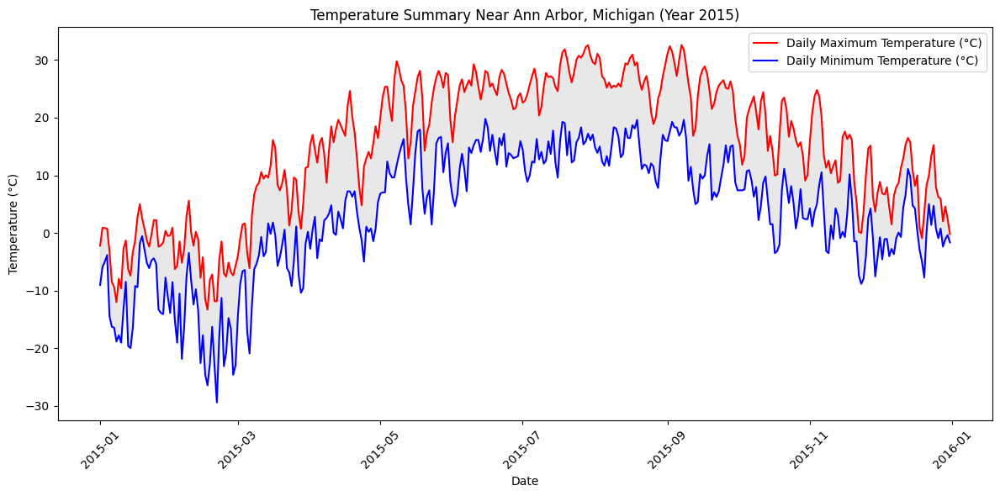

In [34]:
# Plot the data
plt.figure(figsize=(12, 6))
plt.plot(daily_tmax.index, daily_tmax, color='red', label='Daily Maximum Temperature (°C)')
plt.plot(daily_tmin.index, daily_tmin, color='blue', label='Daily Minimum Temperature (°C)')

# Fill between the maximum and minimum temperatures
plt.fill_between(daily_tmax.index, daily_tmax, daily_tmin, color='lightgrey', alpha=0.5)

# Add labels and title
plt.xlabel('Date')
plt.ylabel('Temperature (°C)')
plt.title('Temperature Summary Near Ann Arbor, Michigan (Year 2015)')
plt.legend()

# Format the x-axis for better readability
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()

 The temperature summary for 2015 near Ann Arbor, Michigan provides a comprehensive view of the region's climate patterns, with typical cold winters and warm summers. The graph also highlights significant weather events, including periods of extreme cold and heat, making it useful for understanding the climate variability experienced in this region throughout the year.
